In [9]:
#Importing libraries and dependencies
!pip install yfinance

import pandas as pd
import requests
import numpy as np
import hvplot.pandas
import matplotlib.pyplot as plt
import datetime as dt
import json
import csv
#I dont need all of these, need to comeback 
# and just scrap the ones i dont need later


# Import dotenv package for setting environment variables 
from dotenv import load_dotenv, find_dotenv

# Import os package
import os

print(f'os.getcwd(): {os.getcwd()}')

# Set environment variables from the .env in the local environment
load_dotenv(find_dotenv('keys.env'))

# Retrieve API key and store as Python variable.
# Store your key in keys.env file and name it QuiverQuant_Bearer
api_key = os.getenv("QuiverQuant_Bearer")

print(f'API Key type {type(api_key)}')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 35.4 MB/s eta 0:00:0000:0100:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.6/94.6 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.2/112.2 kB 8.9 MB/s eta 0:00:00
  Created wheel for peewee: filename=peewee-3.17.6-cp310-cp310-macosx_11_0_arm64.whl size=248327 sha256=91ea229ddebfe5105cdf4f74da515fa14c4187b694da4ecca82054efb37b9e95
  Stored in directory: /Users/hbh/Library/Caches/pip/wheels/4b/b9/b0/83d6e258e8f963f5ff111a2cd8c483ca59372a86e6a2535212
Successfully built peewee
os.getcwd(): /Users/hbh/LocalDocs/Training/ASU/Activity Files
API Key type <class 'str'>


In [2]:
#Setting api headpoint, and headers to accept extra info
url = "https://api.quiverquant.com/beta/bulk/congresstrading"
headers = {
    'Accept': "application/json",
    # Use your own API key stored in .env file
    'Authorization': "Bearer " + api_key,
}

print(f'url endpoint: {url}')
#Getting the data
response = requests.get(url, headers=headers)
#Checking if the data was returned
if response.status_code == 200:
    print('200')
    #load json response into the dataframe
    df = pd.read_json(response.content.decode("utf-8"))
    print(df.head())
    print(df.dtypes)
else :
    print(response.status_code)

url endpoint: https://api.quiverquant.com/beta/bulk/congresstrading
200
    Representative BioGuideID  ReportDate TransactionDate  Ticker Transaction  \
0    Mark Dr Green    G000590  2024-10-04      2024-09-30     NGL        Sale   
1  Josh Gottheimer    G000583  2024-10-03      2024-09-27     APH        Sale   
2  Josh Gottheimer    G000583  2024-10-03      2024-09-27      TT        Sale   
3  Josh Gottheimer    G000583  2024-10-03      2024-09-26    PYPL    Purchase   
4   Rudy Yakym Iii    Y000067  2024-09-26      2024-09-26  MATURE    Purchase   

                 Range            House    Amount Party last_modified  
0  $100,001 - $250,000  Representatives  100001.0     R    2024-10-07  
1     $1,001 - $15,000  Representatives    1001.0     D    2024-10-04  
2     $1,001 - $15,000  Representatives    1001.0     D    2024-10-04  
3     $1,001 - $15,000  Representatives    1001.0     D    2024-10-04  
4     $1,001 - $15,000  Representatives    1001.0     R    2024-09-27  
Represent

/var/folders/j3/gtvf75z503q_s625p1nmw4x80000gn/T/ipykernel_5342/3491142597.py:16: FutureWarning: Passing literal json to 'read_json' is deprecated and will be removed in a future version. To read from a literal string, wrap it in a 'StringIO' object.
  df = pd.read_json(response.content.decode("utf-8"))


In [3]:
#Convert the TransactionDate to  datetime
df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])
print(df.dtypes)

Representative             object
BioGuideID                 object
ReportDate                 object
TransactionDate    datetime64[ns]
Ticker                     object
Transaction                object
Range                      object
House                      object
Amount                    float64
Party                      object
last_modified              object
dtype: object


In [4]:
#Check how far back the data goes.
def checkOldest() :
    oldest_date = df['TransactionDate'].min()
    print(oldest_date)
checkOldest()

2012-02-27 00:00:00


In [5]:
# Filter out any data from before 2018 winners took office
inauguration_date =  pd.to_datetime('2019-01-03')
df = df.loc[df['TransactionDate']> inauguration_date]
#Verify old data was removed
checkOldest()
# print(df.head())

2019-01-04 00:00:00


In [7]:
# output the data to a csv file
df.to_csv('congress_trading_2019on.csv', index=False)

/var/folders/j3/gtvf75z503q_s625p1nmw4x80000gn/T/ipykernel_5342/3850870179.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  initial_price = history['Close'][0]
/var/folders/j3/gtvf75z503q_s625p1nmw4x80000gn/T/ipykernel_5342/3850870179.py:22: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  final_price = history['Close'][-1]
/var/folders/j3/gtvf75z503q_s625p1nmw4x80000gn/T/ipykernel_5342/3850870179.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use

Nancy Pelosi's average trade success: 3.57%
Nancy Pelosi's rank among Congress members by average trade success: 53


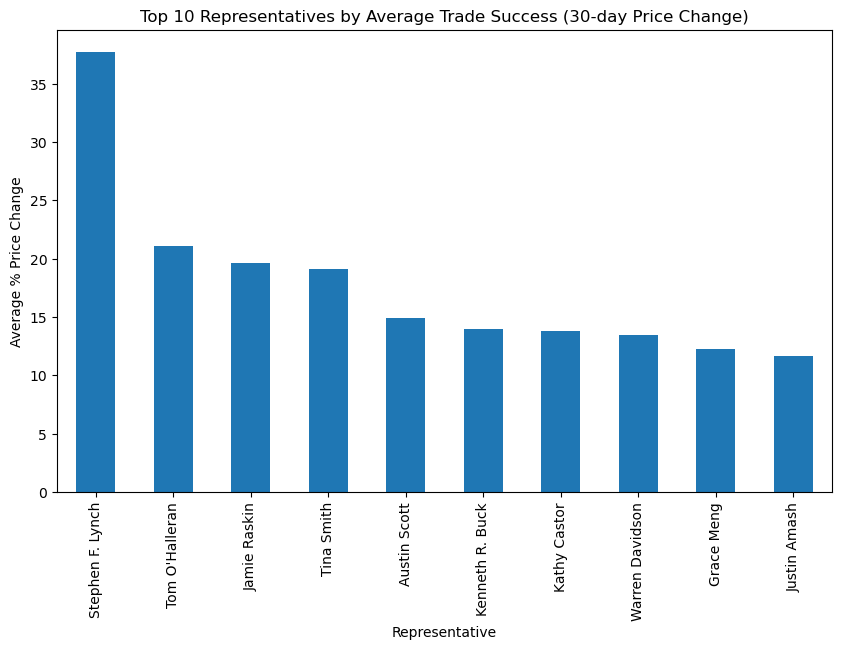

In [10]:
# evaluate successful trades by congress members.
# Successful trades are defined as those that result in a positive return 30 days after the transaction date.
# Calculate the percentage change in stock price 30 days after each transaction

# Note that this took about 85 minutes to run

import yfinance as yf
from datetime import timedelta
import matplotlib.pyplot as plt

def get_stock_price_change(ticker, date):
    """
    Fetches stock price 30 days after the given transaction date 
    to calculate success based on price appreciation.
    """
    try:
        stock = yf.Ticker(ticker)
        start_date = pd.to_datetime(date)
        end_date = start_date + timedelta(days=30)
        history = stock.history(start=start_date, end=end_date)

        if len(history) > 0:
            initial_price = history['Close'][0]
            final_price = history['Close'][-1]
            # Calculate percentage change
            price_change = ((final_price - initial_price) / initial_price) * 100
            return price_change
        else:
            return None
    except Exception as e:
        print(f"Error retrieving data for {ticker} on {date}: {e}")
        return None

# Apply function to DataFrame
df['PriceChange30d'] = df.apply(lambda row: get_stock_price_change(row['Ticker'], row['TransactionDate']), axis=1)

# Calculate average success rate by Representative
success_by_rep = df.groupby('Representative')['PriceChange30d'].mean().sort_values(ascending=False)

# Identify Pelosi’s rank and success rate
pelosi_success = success_by_rep.loc["Nancy Pelosi"] if "Nancy Pelosi" in success_by_rep.index else None
pelosi_rank = success_by_rep.reset_index().index[success_by_rep.index == "Nancy Pelosi"][0] + 1 if pelosi_success else "Not found"

# Display summary of results
print(f"Nancy Pelosi's average trade success: {pelosi_success:.2f}%")
print(f"Nancy Pelosi's rank among Congress members by average trade success: {pelosi_rank}")

# Visualization: Plot top 10 Representatives by trade success
top_10_reps = success_by_rep.head(10)
plt.figure(figsize=(10, 6))
top_10_reps.plot(kind='bar', title='Top 10 Representatives by Average Trade Success (30-day Price Change)', ylabel='Average % Price Change')
plt.show()

This is interesting because Sephen Lynch is:
A senior member of the House Committee on Financial Services
He also served as Chairman of the Task Force on Financial Technology for the 116th and 117th Congress
currently serves as Ranking Member of the Subcommittee on Digital Assets, Financial Technology and Inclusion, which is authorized to conduct oversight of cryptocurrencies, stablecoins, and other digital assets, examine the accessibility of financial technology, and review the progress of diversity and inclusion initiatives in the financial technology sector. Congressman Lynch is also a member of the Subcommittee on Capital Markets.

21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:36 - cmdstanpy - INFO - Chain [1] done processing
/opt/anaconda3/envs/dev/lib/python3.10/site-packages/prophet/plot.py:72: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  fcst_t = fcst['ds'].dt.to_pydatetime()
/opt/anaconda3/envs/dev/lib/python3.10/site-packages/prophet/plot.py:73: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  ax.plot(m.history['ds'].dt.to_pydatetime(), m.history['y'], 'k.',


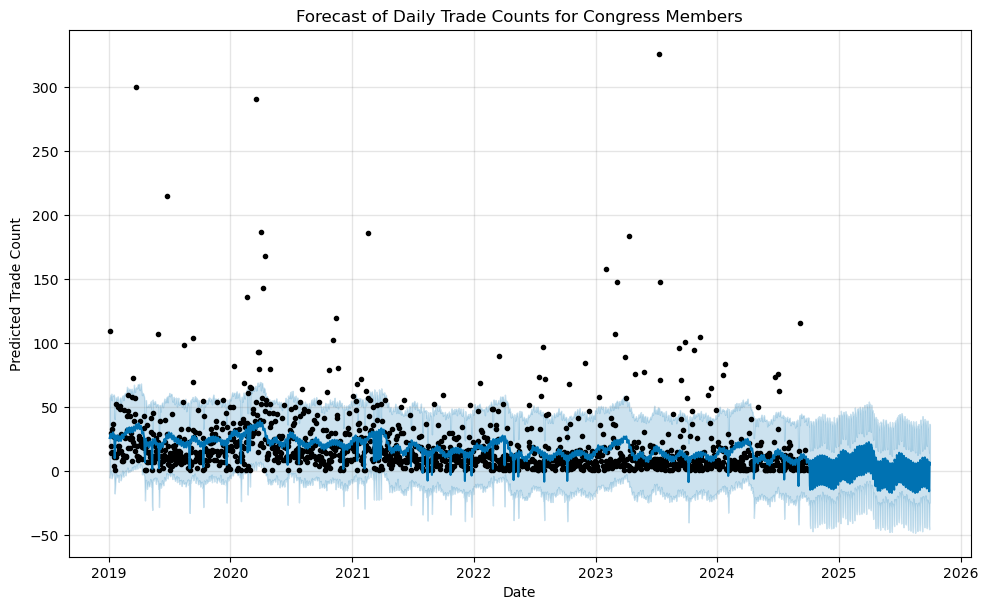

/opt/anaconda3/envs/dev/lib/python3.10/site-packages/prophet/plot.py:228: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  fcst_t = fcst['ds'].dt.to_pydatetime()
/opt/anaconda3/envs/dev/lib/python3.10/site-packages/prophet/plot.py:351: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  df_y['ds'].dt.to_pydatetime(), seas[name], ls='-', c='#0072B2')
/opt/anaconda3/envs/dev/lib/python3.10/site-packages/prophet/plot.py:354: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To ret

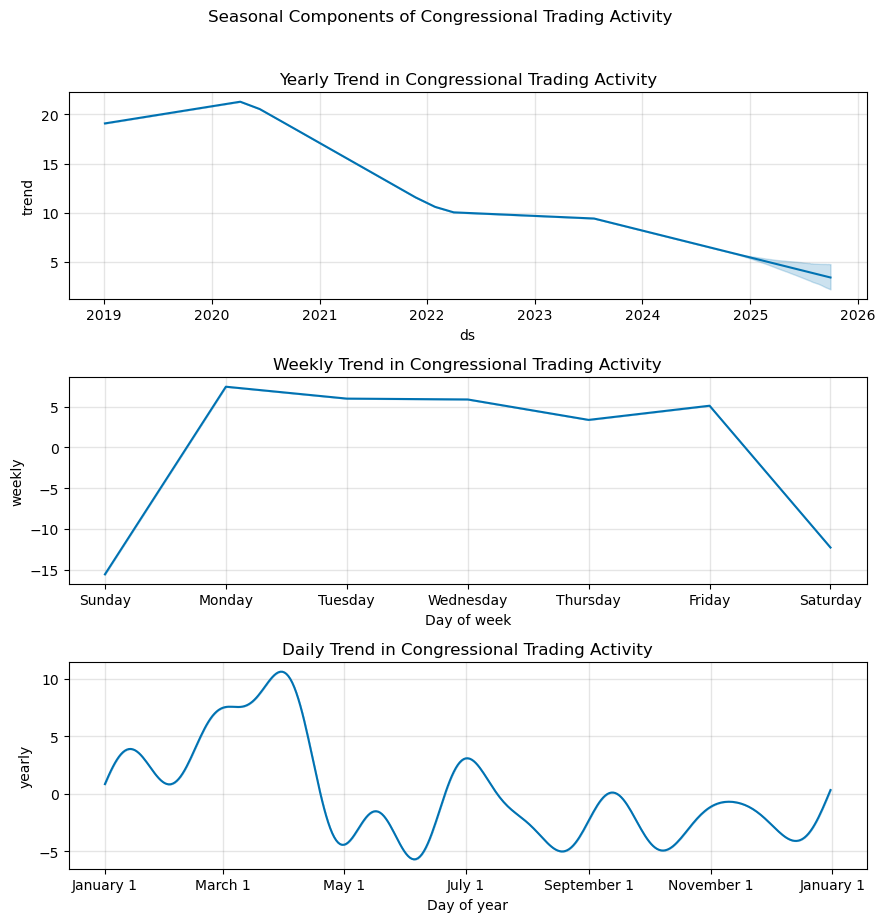

In [16]:
# Next, let's use Prophet for identifying seasonality in congressional trading activity
# Prophet-Based Seasonality Analysis

# 	1.	Aggregate Trade Counts by Date:
# 	•	Aggregate the number of trades per day across all Congress members. This will give a time series of daily trade counts.
# 	2.	Prepare Data for Prophet:
# 	•	Prophet requires a DataFrame with columns ds (date) and y (values to forecast). We’ll set y as the daily trade count.
# 	3.	Fit and Forecast Using Prophet:
# 	•	Fit the Prophet model to the daily trade counts and examine seasonal components such as weekly and yearly trends.
# 	4.	Visualize Seasonal Components:
# 	•	Use Prophet’s built-in plot functions to see seasonal patterns.

# Expected output:
# Overall Forecast Plot: Displays the forecasted daily trade counts, with confidence intervals.
# Seasonal Components Plot: Shows the detected yearly, weekly, and daily trends, highlighting if certain times of the year or days of the week see more trading activity.


# Step 0: Install prophet, suppressing warnings if requirements are already satisfied
import subprocess
import sys

# Install prophet quietly if not installed
try:
    import prophet
except ImportError:
    subprocess.check_call([sys.executable, "-m", "pip", "install", "prophet", "--quiet"])

from prophet import Prophet
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Aggregate the data by daily trade counts
df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])  # Ensure date is in datetime format
daily_trades = df.groupby('TransactionDate').size().reset_index(name='trade_count')

# Step 2: Prepare Data for Prophet
prophet_df = daily_trades.rename(columns={'TransactionDate': 'ds', 'trade_count': 'y'})

# Step 3: Fit the Prophet Model
model = Prophet(yearly_seasonality=True, weekly_seasonality=True)
model.fit(prophet_df)

# Step 4: Forecast
future = model.make_future_dataframe(periods=365)  # Extend future for 1 year to observe seasonality
forecast = model.predict(future)

# Step 5: Plot Forecast
fig1 = model.plot(forecast)
plt.title("Forecast of Daily Trade Counts for Congress Members")
plt.xlabel("Date")
plt.ylabel("Predicted Trade Count")
plt.show()

# Step 6: Plot Seasonal Components
fig2 = model.plot_components(forecast)
fig2.suptitle("Seasonal Components of Congressional Trading Activity", y=1.02)

# Customizing each subplot within the components plot
ax1, ax2, ax3 = fig2.get_axes()

# Adding titles to each component for clarity
ax1.set_title("Yearly Trend in Congressional Trading Activity")
ax2.set_title("Weekly Trend in Congressional Trading Activity")
ax3.set_title("Daily Trend in Congressional Trading Activity")

# Displaying each subplot title
plt.tight_layout()
plt.show()

Calculating ROI for each trade:   0%|                               | 4/27911 [00:10<16:12:38,  2.09s/it]Failed to get ticker 'MATURE' reason: ('Connection aborted.', RemoteDisconnected('Remote end closed connection without response'))
$MATURE: possibly delisted; no timezone found
Calculating ROI for each trade:   1%|▍                               | 349/27911 [01:44<56:50,  8.08it/s]$BRKB: possibly delisted; no timezone found
$T$A: possibly delisted; no timezone found
Calculating ROI for each trade:   1%|▍                             | 377/27911 [01:49<1:13:06,  6.28it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:   5%|█▎                           | 1319/27911 [03:39<1:07:29,  6.57it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:   6%|█▊                             | 1629/27911 [04:16<26:

Average ROI (90 days) for Top 10 Representatives:
Representative
Warren Davidson      54.728861
Austin Scott         45.587934
Thomas Massie        43.064347
Stephen F. Lynch     36.925405
Thomas R. Suozzi     28.627424
Tina Smith           26.239156
Justin Amash         25.931166
Deborah Ross         25.074363
Alan S. Lowenthal    24.843884
Morgan Mcgarvey      24.135319
Name: ROI_90d, dtype: float64

Overall Mean ROI for Top 10 Representatives: 33.52%


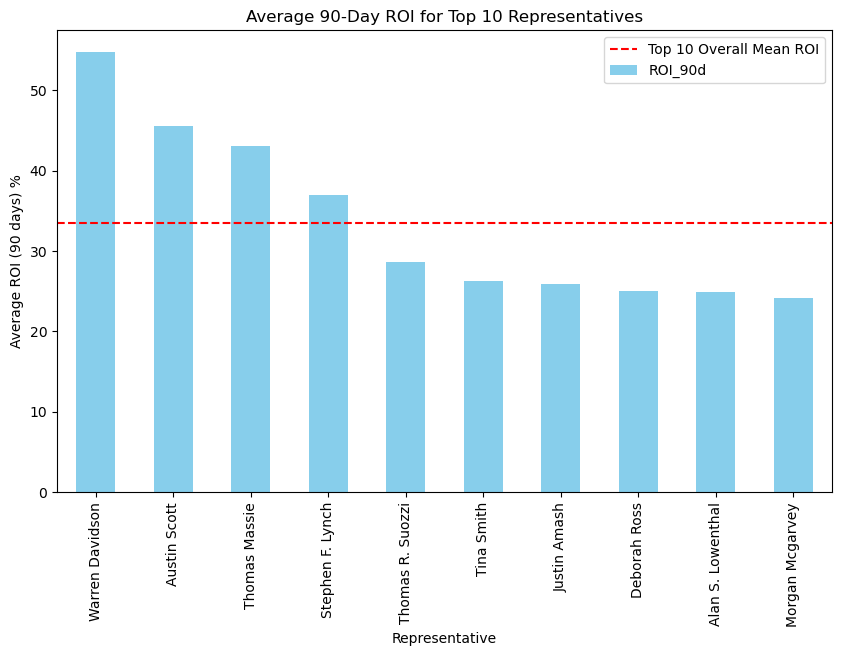

In [19]:
# provide an evaluation of trade success by Congress members, giving insights into who has a track record of profitable trades.

	# 1.	Overall Average ROI: Displays the mean 30-day ROI across all trades as a baseline.
	# 2.	Representatives with Above-Average Trading Success: Lists members whose average 90-day ROI is above the overall average.
	# 3.	Visualization: Shows a bar plot of each representative’s average ROI, with a red line indicating the overall mean, highlighting which members exceed this benchmark.


# Step 0: Install necessary packages (yfinance and tqdm) quietly if not already installed
import subprocess
import sys

# Install yfinance and tqdm with --quiet flag if not already installed
try:
    import yfinance as yf
except ImportError:
    subprocess.check_call([sys.executable, "-m", "pip", "install", "yfinance", "--quiet"])

try:
    from tqdm import tqdm
except ImportError:
    subprocess.check_call([sys.executable, "-m", "pip", "install", "tqdm", "--quiet"])

from datetime import timedelta
import pandas as pd
from tqdm import tqdm

# Function to calculate ROI over a 90-day period post-transaction
def calculate_trade_roi(ticker, transaction_date):
    try:
        stock = yf.Ticker(ticker)
        start_date = pd.to_datetime(transaction_date)
        end_date = start_date + timedelta(days=90)
        history = stock.history(start=start_date, end=end_date)

        if len(history) > 1:
            initial_price = history['Close'].iloc[0]
            final_price = history['Close'].iloc[-1]
            # Calculate ROI as percentage
            roi = ((final_price - initial_price) / initial_price) * 100
            return roi
        else:
            return None
    except Exception as e:
        print(f"Error retrieving data for {ticker} on {transaction_date}: {e}")
        return None

# Apply ROI calculation with progress indicator
df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])
tqdm.pandas(desc="Calculating ROI for each trade")
df['ROI_90d'] = df.progress_apply(lambda row: calculate_trade_roi(row['Ticker'], row['TransactionDate']), axis=1)

# Calculate average ROI per Representative
average_roi_by_rep = df.groupby('Representative')['ROI_90d'].mean().dropna().sort_values(ascending=False)

# Select top 10 Representatives by average ROI
top_10_reps = average_roi_by_rep.head(10)

# Calculate overall mean ROI for the top 10
top_10_mean_roi = top_10_reps.mean()

# Print summary
print("Average ROI (90 days) for Top 10 Representatives:")
print(top_10_reps)
print("\nOverall Mean ROI for Top 10 Representatives: {:.2f}%".format(top_10_mean_roi))

# Visualization of Average ROI for Top 10 Representatives
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
top_10_reps.plot(kind='bar', color='skyblue')
plt.axhline(top_10_mean_roi, color='red', linestyle='--', label='Top 10 Overall Mean ROI')
plt.xlabel("Representative")
plt.ylabel("Average ROI (90 days) %")
plt.title("Average 90-Day ROI for Top 10 Representatives")
plt.legend()
plt.show()

Analyzing Legislative Dates: 100%|██████████████████████████████████████████████| 10/10 [00:00<00:00, 1172.58it/s]


Top 10 Trading Patterns Around Key Legislative Dates:
                                 Bill Legislative Date Window Start  \
8      Defense Spending Authorization       2024-01-20   2023-12-21   
5        Data Privacy Protection Bill       2024-04-25   2024-03-26   
4       Pharmaceutical Pricing Reform       2024-02-10   2024-01-11   
6  Agriculture Export Enhancement Act       2024-08-15   2024-07-16   
3            Banking Transparency Act       2024-03-01   2024-01-31   
9  Transportation Infrastructure Bill       2024-10-10   2024-09-10   
1              Healthcare Reform Bill       2024-06-10   2024-05-11   
0       Tech Industry Regulation Bill       2024-05-15   2024-04-15   
2                  Energy Subsidy Act       2024-07-20   2024-06-20   
7         Renewable Energy Incentives       2024-09-30   2024-08-31   

  Window End  Trade Count  Average Amount    Industry  
8 2024-02-19          502    29927.892709       Other  
5 2024-05-25          451    20515.412417       Othe

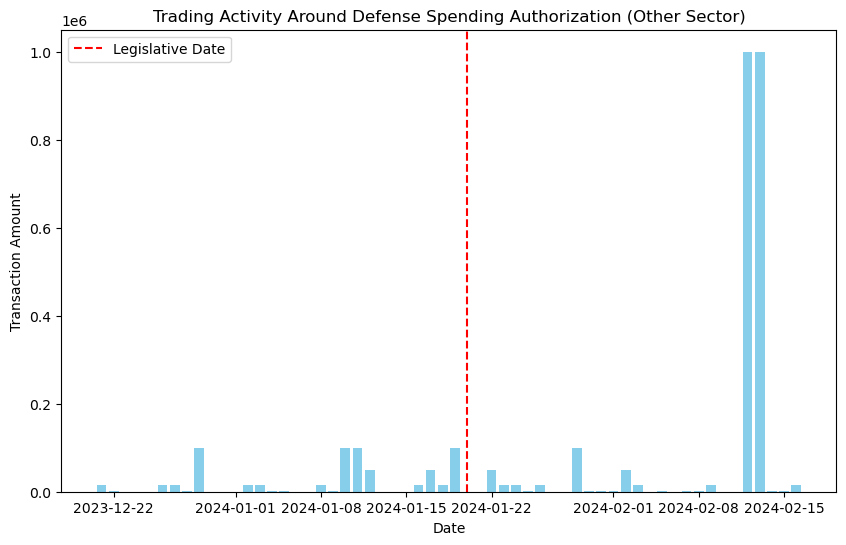

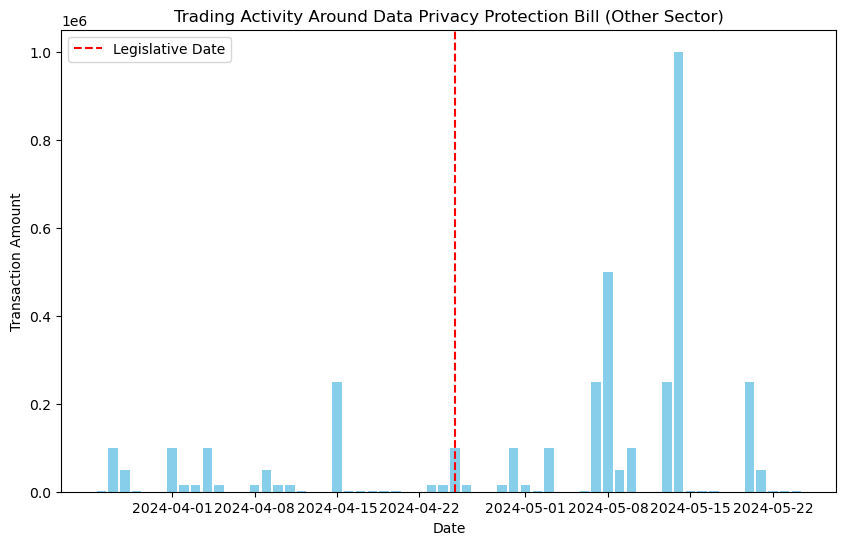

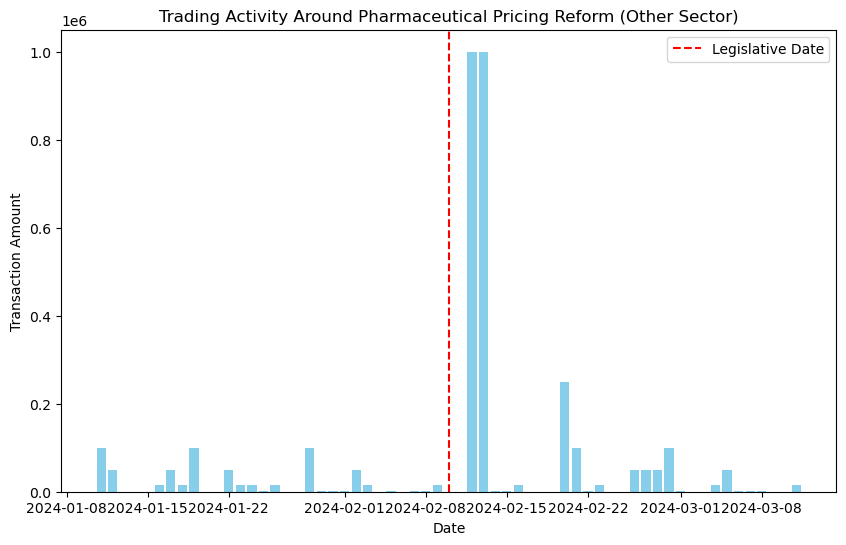

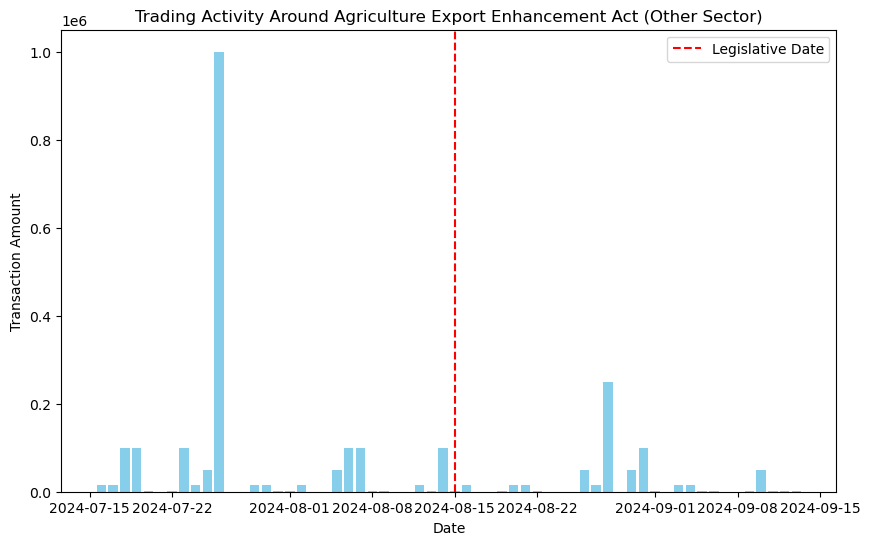

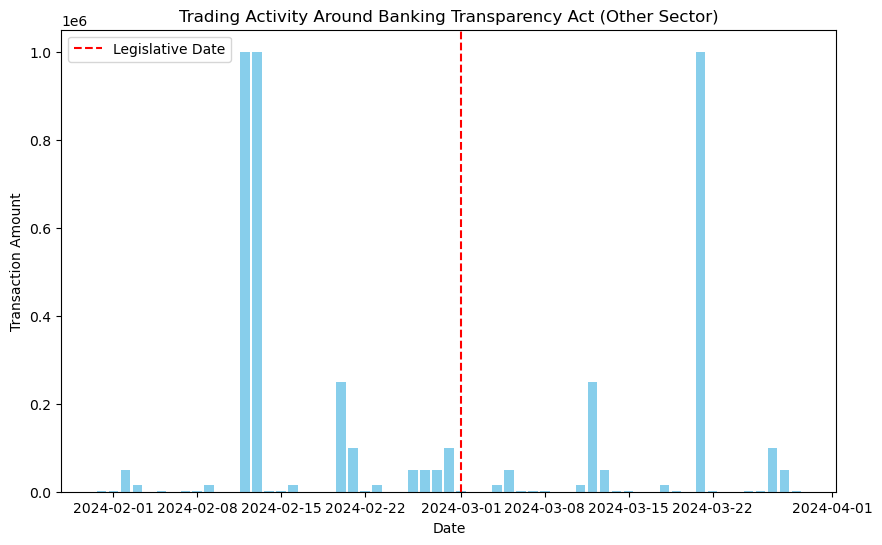

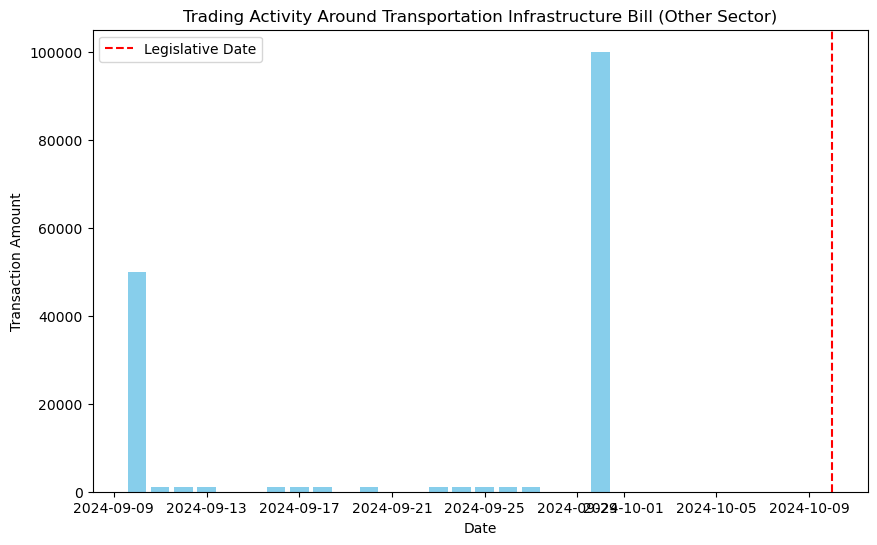

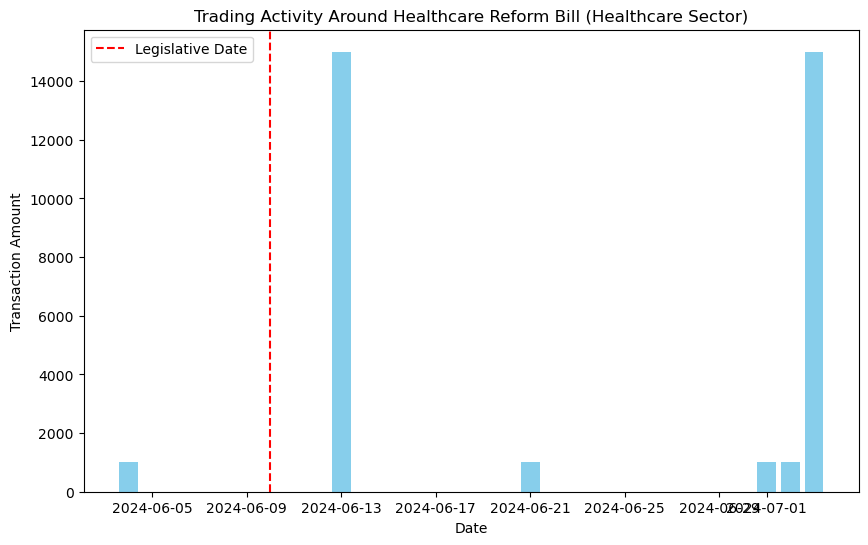

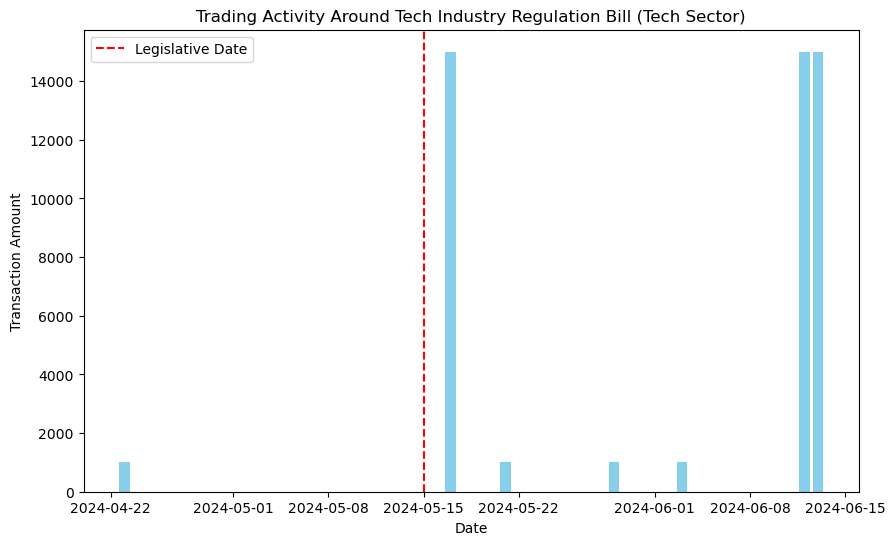

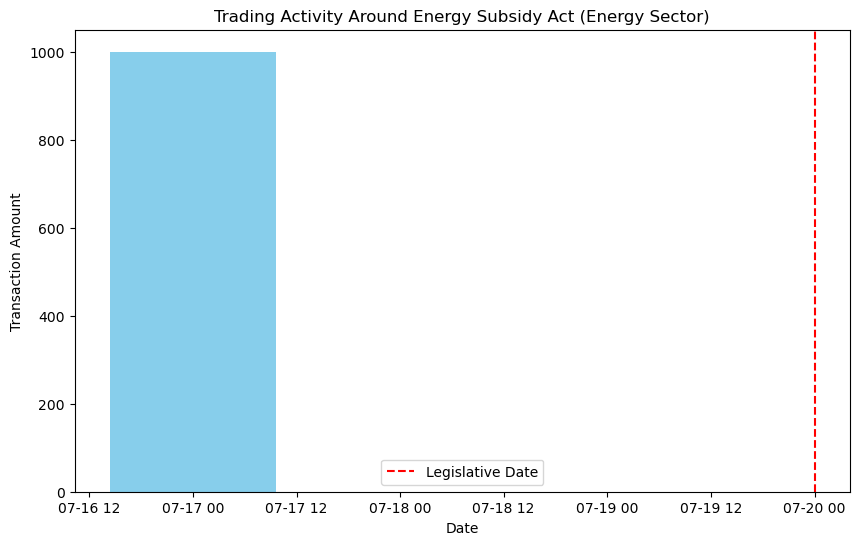

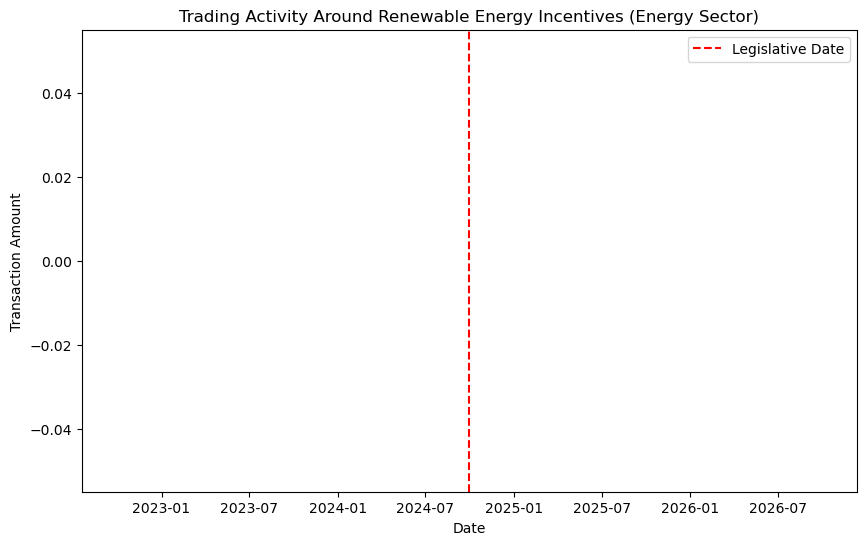

In [20]:
import pandas as pd
from datetime import timedelta
import matplotlib.pyplot as plt
from tqdm import tqdm
import warnings

# Suppress warnings
warnings.filterwarnings("ignore")

# Example key legislative dates related to industry-affecting bills
legislative_dates = {
    "Tech Industry Regulation Bill": "2024-05-15",
    "Healthcare Reform Bill": "2024-06-10",
    "Energy Subsidy Act": "2024-07-20",
    "Banking Transparency Act": "2024-03-01",
    "Pharmaceutical Pricing Reform": "2024-02-10",
    "Data Privacy Protection Bill": "2024-04-25",
    "Agriculture Export Enhancement Act": "2024-08-15",
    "Renewable Energy Incentives": "2024-09-30",
    "Defense Spending Authorization": "2024-01-20",
    "Transportation Infrastructure Bill": "2024-10-10"
}

# Convert legislative dates to datetime
legislative_dates = {k: pd.to_datetime(v) for k, v in legislative_dates.items()}

# Define a time window (30 days before and after each legislative event)
window_days = 30

# Placeholder function to map each ticker to an industry
def get_industry_by_ticker(ticker):
    industry_mapping = {
        "AAPL": "Tech",
        "AMZN": "Tech",
        "JNJ": "Healthcare",
        "XOM": "Energy",
        # Add other tickers and their respective industries here
    }
    return industry_mapping.get(ticker, "Other")

# Apply industry mapping to trades
df['Industry'] = df['Ticker'].apply(get_industry_by_ticker)

# Analyze trading patterns around each legislative date with progress tracking
pattern_analysis = []
for bill, date in tqdm(legislative_dates.items(), desc="Analyzing Legislative Dates"):
    # Set the 30-day window around the legislative date
    window_start = date - timedelta(days=window_days)
    window_end = date + timedelta(days=window_days)
    trades_in_window = df[(df['TransactionDate'] >= window_start) & (df['TransactionDate'] <= window_end)]

    # Filter trades relevant to the legislation's industry
    industry_of_interest = "Tech" if "Tech" in bill else "Healthcare" if "Healthcare" in bill else "Energy" if "Energy" in bill else "Other"
    trades_in_industry = trades_in_window[trades_in_window['Industry'] == industry_of_interest]

    # Calculate trade count and average transaction amount in the industry
    trade_count = trades_in_industry.shape[0]
    avg_amount = trades_in_industry['Amount'].mean()
    
    # Append analysis results
    pattern_analysis.append({
        "Bill": bill,
        "Legislative Date": date,
        "Window Start": window_start,
        "Window End": window_end,
        "Trade Count": trade_count,
        "Average Amount": avg_amount,
        "Industry": industry_of_interest
    })

# Convert to DataFrame and select top 10 events by trade count
pattern_analysis_df = pd.DataFrame(pattern_analysis).nlargest(10, 'Trade Count')

# Display results
print("Top 10 Trading Patterns Around Key Legislative Dates:")
print(pattern_analysis_df)

# Visualization: Plot trading activity around each of the top 10 legislative dates
for _, row in pattern_analysis_df.iterrows():
    plt.figure(figsize=(10, 6))
    
    # Filter trades within the specific date window and industry
    trades_near_date = df[(df['TransactionDate'] >= row["Window Start"]) & 
                          (df['TransactionDate'] <= row["Window End"]) & 
                          (df['Industry'] == row["Industry"])]
    trade_dates = trades_near_date['TransactionDate']
    trade_amounts = trades_near_date['Amount']

    plt.bar(trade_dates, trade_amounts, color='skyblue')
    plt.axvline(row["Legislative Date"], color='red', linestyle='--', label='Legislative Date')
    plt.xlabel("Date")
    plt.ylabel("Transaction Amount")
    plt.title(f"Trading Activity Around {row['Bill']} ({row['Industry']} Sector)")
    plt.legend()
    plt.show()

Calculating 90-Day ROI for Congress Trades


Calculating ROI for each trade:   1%|▍                               | 349/27911 [00:45<51:39,  8.89it/s]$BRKB: possibly delisted; no timezone found
$T$A: possibly delisted; no timezone found
Calculating ROI for each trade:   1%|▍                               | 378/27911 [00:50<57:02,  8.05it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:   5%|█▎                           | 1319/27911 [02:46<1:10:15,  6.31it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:  10%|██▉                          | 2773/27911 [05:40<2:06:15,  3.32it/s]$ATVI: possibly delisted; no timezone found
$GLAS FUNDS, LP: possibly delisted; no timezone found
Calculating ROI for each trade:  12%|███▌                         | 3481/27911 [07:28<1:45:41,  3.85it/s]$WTT: possibly delisted; no timezone found
$WTT: possibly delisted; no timezone found
Calculating ROI for each

Calculating 90-Day ROI for S&P 500 (Congress Period)


Calculating ROI for each trade: 100%|█████████████████████████████| 27911/27911 [04:02<00:00, 115.18it/s]


Calculating 90-Day ROI for NASDAQ (Congress Period)


Calculating ROI for each trade: 100%|█████████████████████████████| 27911/27911 [04:04<00:00, 114.21it/s]


Average 90-Day ROI Comparison:
Congress Trades ROI: 5.12%
S&P 500 ROI (Same Period as Congress Trades): 4.52%
NASDAQ ROI (Same Period as Congress Trades): 6.11%
Nancy Pelosi's Trades ROI: 8.33%
S&P 500 ROI (Same Period as Pelosi's Trades): 3.09%
NASDAQ ROI (Same Period as Pelosi's Trades): 4.65%


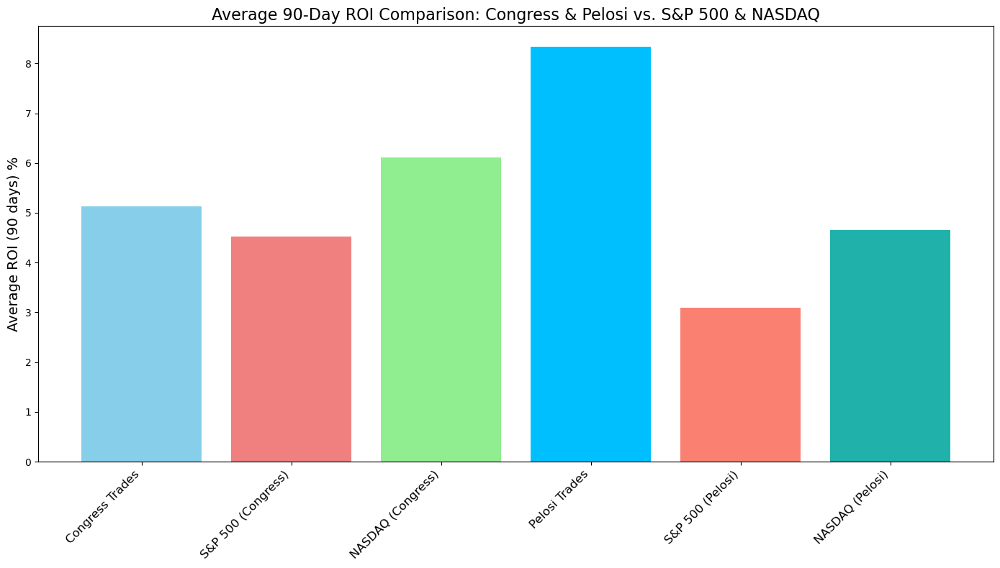

In [22]:
import pandas as pd
import yfinance as yf
from datetime import timedelta
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings

# Suppress warnings
warnings.filterwarnings("ignore")

# Define tickers for S&P 500 and NASDAQ
sp500_ticker = "^GSPC"
nasdaq_ticker = "^IXIC"

# Function to calculate 90-day ROI
def calculate_90d_roi(ticker, transaction_date):
    try:
        stock = yf.Ticker(ticker)
        start_date = pd.to_datetime(transaction_date)
        end_date = start_date + timedelta(days=90)
        history = stock.history(start=start_date, end=end_date)

        if len(history) > 1:
            initial_price = history['Close'].iloc[0]
            final_price = history['Close'].iloc[-1]
            roi = ((final_price - initial_price) / initial_price) * 100
            return roi
        else:
            return None
    except Exception as e:
        print(f"Error retrieving data for {ticker} on {transaction_date}: {e}")
        return None

# Calculate 90-day ROI for each trade and the corresponding S&P 500 and NASDAQ ROI
df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])

# Apply progress bars with tqdm for Congress trades, S&P 500, and NASDAQ calculations
print("Calculating 90-Day ROI for Congress Trades")
df['Trade_ROI_90d'] = df.progress_apply(lambda row: calculate_90d_roi(row['Ticker'], row['TransactionDate']), axis=1)

print("Calculating 90-Day ROI for S&P 500 (Congress Period)")
df['SP500_ROI_90d'] = df['TransactionDate'].progress_apply(lambda date: calculate_90d_roi(sp500_ticker, date))

print("Calculating 90-Day ROI for NASDAQ (Congress Period)")
df['NASDAQ_ROI_90d'] = df['TransactionDate'].progress_apply(lambda date: calculate_90d_roi(nasdaq_ticker, date))

# Filter for Nancy Pelosi's trades
pelosi_trades = df[df['Representative'] == 'Nancy Pelosi']

# Calculate average ROI for Congress trades, Pelosi trades, S&P 500, and NASDAQ
congress_avg_trade_roi = df['Trade_ROI_90d'].mean()
congress_avg_sp500_roi = df['SP500_ROI_90d'].mean()
congress_avg_nasdaq_roi = df['NASDAQ_ROI_90d'].mean()
pelosi_avg_trade_roi = pelosi_trades['Trade_ROI_90d'].mean()
pelosi_avg_sp500_roi = pelosi_trades['SP500_ROI_90d'].mean()
pelosi_avg_nasdaq_roi = pelosi_trades['NASDAQ_ROI_90d'].mean()

# Print summary of results
print("Average 90-Day ROI Comparison:")
print(f"Congress Trades ROI: {congress_avg_trade_roi:.2f}%")
print(f"S&P 500 ROI (Same Period as Congress Trades): {congress_avg_sp500_roi:.2f}%")
print(f"NASDAQ ROI (Same Period as Congress Trades): {congress_avg_nasdaq_roi:.2f}%")
print(f"Nancy Pelosi's Trades ROI: {pelosi_avg_trade_roi:.2f}%")
print(f"S&P 500 ROI (Same Period as Pelosi's Trades): {pelosi_avg_sp500_roi:.2f}%")
print(f"NASDAQ ROI (Same Period as Pelosi's Trades): {pelosi_avg_nasdaq_roi:.2f}%")

# Visualization with larger figure size, rotated x-axis labels, and adjusted font size
plt.figure(figsize=(14, 8))
plt.bar(['Congress Trades', 'S&P 500 (Congress)', 'NASDAQ (Congress)', 
         'Pelosi Trades', 'S&P 500 (Pelosi)', 'NASDAQ (Pelosi)'],
        [congress_avg_trade_roi, congress_avg_sp500_roi, congress_avg_nasdaq_roi,
         pelosi_avg_trade_roi, pelosi_avg_sp500_roi, pelosi_avg_nasdaq_roi],
        color=['skyblue', 'lightcoral', 'lightgreen', 'deepskyblue', 'salmon', 'lightseagreen'])
plt.xticks(rotation=45, ha="right", fontsize=12)
plt.ylabel("Average ROI (90 days) %", fontsize=14)
plt.title("Average 90-Day ROI Comparison: Congress & Pelosi vs. S&P 500 & NASDAQ", fontsize=16)
plt.tight_layout()  # Adjust layout to fit elements within the figure area
plt.show()

In [23]:
import pandas as pd
import yfinance as yf
from datetime import timedelta
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings

# Suppress warnings
warnings.filterwarnings("ignore")

# Define tickers for S&P 500 and NASDAQ
sp500_ticker = "^GSPC"
nasdaq_ticker = "^IXIC"

# Function to calculate 90-day ROI only if the transaction date is from 2019 onwards
def calculate_90d_roi(ticker, transaction_date):
    # Only proceed if the transaction date is from 2019 onwards
    if pd.to_datetime(transaction_date) < pd.to_datetime("2019-01-01"):
        return None  # Skip dates before 2019
    try:
        stock = yf.Ticker(ticker)
        start_date = pd.to_datetime(transaction_date)
        end_date = start_date + timedelta(days=90)
        history = stock.history(start=start_date, end=end_date)

        if len(history) > 1:
            initial_price = history['Close'].iloc[0]
            final_price = history['Close'].iloc[-1]
            roi = ((final_price - initial_price) / initial_price) * 100
            return roi
        else:
            return None
    except Exception as e:
        print(f"Error retrieving data for {ticker} on {transaction_date}: {e}")
        return None

# Calculate 90-day ROI for each trade and the corresponding S&P 500 and NASDAQ ROI
df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])

# Apply progress bars with tqdm for Congress trades, S&P 500, and NASDAQ calculations
print("Calculating 90-Day ROI for Congress Trades")
df['Trade_ROI_90d'] = df.progress_apply(lambda row: calculate_90d_roi(row['Ticker'], row['TransactionDate']), axis=1)

print("Calculating 90-Day ROI for S&P 500 (Congress Period)")
df['SP500_ROI_90d'] = df['TransactionDate'].progress_apply(lambda date: calculate_90d_roi(sp500_ticker, date))

print("Calculating 90-Day ROI for NASDAQ (Congress Period)")
df['NASDAQ_ROI_90d'] = df['TransactionDate'].progress_apply(lambda date: calculate_90d_roi(nasdaq_ticker, date))

# Filter for Nancy Pelosi's trades
pelosi_trades = df[df['Representative'] == 'Nancy Pelosi']

# Calculate average ROI for Congress trades, Pelosi trades, S&P 500, and NASDAQ
congress_avg_trade_roi = df['Trade_ROI_90d'].mean()
congress_avg_sp500_roi = df['SP500_ROI_90d'].mean()
congress_avg_nasdaq_roi = df['NASDAQ_ROI_90d'].mean()
pelosi_avg_trade_roi = pelosi_trades['Trade_ROI_90d'].mean()
pelosi_avg_sp500_roi = pelosi_trades['SP500_ROI_90d'].mean()
pelosi_avg_nasdaq_roi = pelosi_trades['NASDAQ_ROI_90d'].mean()




Calculating 90-Day ROI for Congress Trades


Calculating ROI for each trade:   1%|▍                               | 349/27911 [00:47<52:29,  8.75it/s]$BRKB: possibly delisted; no timezone found
$T$A: possibly delisted; no timezone found
Calculating ROI for each trade:   1%|▍                             | 377/27911 [00:52<1:17:53,  5.89it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:   5%|█▎                           | 1319/27911 [02:55<1:12:34,  6.11it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:  10%|██▉                          | 2773/27911 [06:02<2:09:00,  3.25it/s]$ATVI: possibly delisted; no timezone found
$GLAS FUNDS, LP: possibly delisted; no timezone found
Calculating ROI for each trade:  12%|███▌                         | 3481/27911 [07:53<1:45:25,  3.86it/s]$WTT: possibly delisted; no timezone found
$WTT: possibly deliste

Calculating 90-Day ROI for S&P 500 (Congress Period)


Calculating ROI for each trade: 100%|█████████████████████████████| 27911/27911 [04:17<00:00, 108.44it/s]


Calculating 90-Day ROI for NASDAQ (Congress Period)


Calculating ROI for each trade: 100%|█████████████████████████████| 27911/27911 [04:14<00:00, 109.51it/s]


Average 90-Day ROI Comparison:
Congress Trades ROI: 5.10%
S&P 500 ROI (Same Period as Congress Trades): 4.52%
NASDAQ ROI (Same Period as Congress Trades): 6.12%
Nancy Pelosi's Trades ROI: 8.34%
S&P 500 ROI (Same Period as Pelosi's Trades): 3.09%
NASDAQ ROI (Same Period as Pelosi's Trades): 4.65%


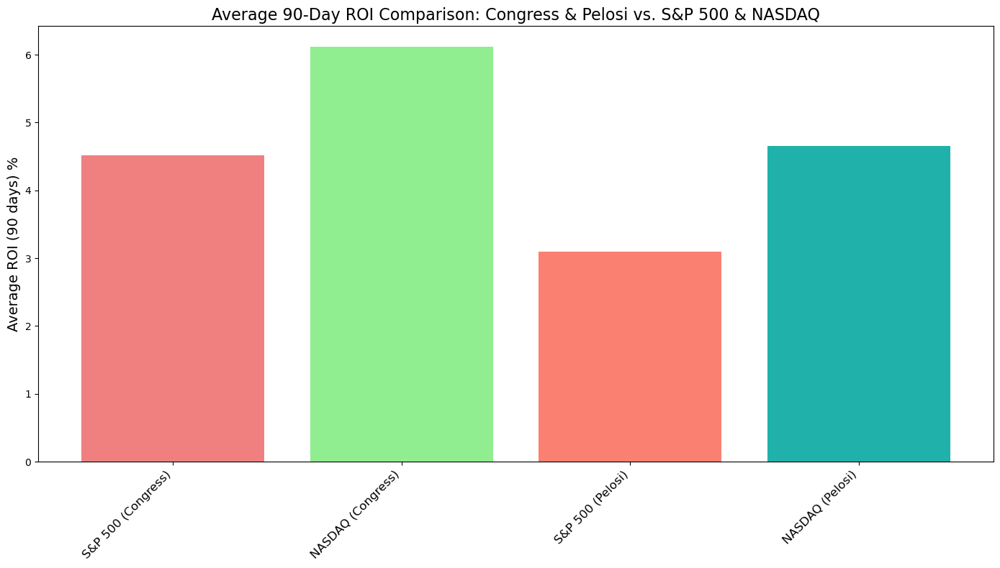

In [26]:
# Print summary of results
print("Average 90-Day ROI Comparison:")
print(f"Congress Trades ROI: {congress_avg_trade_roi:.2f}%")
print(f"S&P 500 ROI (Same Period as Congress Trades): {congress_avg_sp500_roi:.2f}%")
print(f"NASDAQ ROI (Same Period as Congress Trades): {congress_avg_nasdaq_roi:.2f}%")
print(f"Nancy Pelosi's Trades ROI: {pelosi_avg_trade_roi:.2f}%")
print(f"S&P 500 ROI (Same Period as Pelosi's Trades): {pelosi_avg_sp500_roi:.2f}%")
print(f"NASDAQ ROI (Same Period as Pelosi's Trades): {pelosi_avg_nasdaq_roi:.2f}%")


# Visualization with larger figure size, rotated x-axis labels, and adjusted font size
plt.figure(figsize=(14, 8))
# plt.bar(['Congress Trades', 'S&P 500 (Congress)', 'NASDAQ (Congress)', 
#          'Pelosi Trades', 'S&P 500 (Pelosi)', 'NASDAQ (Pelosi)'],
#         [congress_avg_trade_roi, congress_avg_sp500_roi, congress_avg_nasdaq_roi,
#          pelosi_avg_trade_roi, pelosi_avg_sp500_roi, pelosi_avg_nasdaq_roi],
#         color=['skyblue', 'lightcoral', 'lightgreen', 'deepskyblue', 'salmon', 'lightseagreen'])
# I decided against putting Pelosi and Congress bars in there because it's not comparing apples to apples
plt.bar(['S&P 500 (Congress)', 'NASDAQ (Congress)', 
         'S&P 500 (Pelosi)', 'NASDAQ (Pelosi)'],
        [congress_avg_sp500_roi, congress_avg_nasdaq_roi,
         pelosi_avg_sp500_roi, pelosi_avg_nasdaq_roi],
        color=['lightcoral', 'lightgreen', 'salmon', 'lightseagreen'])
plt.xticks(rotation=45, ha="right", fontsize=12)
plt.ylabel("Average ROI (90 days) %", fontsize=14)
plt.title("Average 90-Day ROI Comparison: Congress & Pelosi vs. S&P 500 & NASDAQ", fontsize=16)
plt.tight_layout()  # Adjust layout to fit elements within the figure area
plt.show()

API Key type: <class 'str'>
URL endpoint: https://api.quiverquant.com/beta/bulk/congresstrading
Successfully retrieved data (status code 200)
               Representative BioGuideID  ReportDate TransactionDate Ticker  \
0  Marjorie Taylor Mrs Greene    G000596  2024-10-08      2024-10-04    FDX   
1  Marjorie Taylor Mrs Greene    G000596  2024-10-08      2024-10-04      V   
2  Marjorie Taylor Mrs Greene    G000596  2024-10-08      2024-10-04   LRCX   
3  Marjorie Taylor Mrs Greene    G000596  2024-10-08      2024-10-04   ASML   
4  Marjorie Taylor Mrs Greene    G000596  2024-10-08      2024-10-04   DELL   

  Transaction             Range            House  Amount Party last_modified  
0    Purchase  $1,001 - $15,000  Representatives  1001.0     R    2024-10-09  
1    Purchase  $1,001 - $15,000  Representatives  1001.0     R    2024-10-09  
2    Purchase  $1,001 - $15,000  Representatives  1001.0     R    2024-10-09  
3    Purchase  $1,001 - $15,000  Representatives  1001.0     R    2

Calculating ROI for each trade: 100%|████████████████████████████| 48243/48243 [00:07<00:00, 6745.27it/s]


Average 90-Day ROI Comparison using QuiverQuant data:
Congress Trades ROI: 10.00%
Nancy Pelosi's Trades ROI: 10.00%


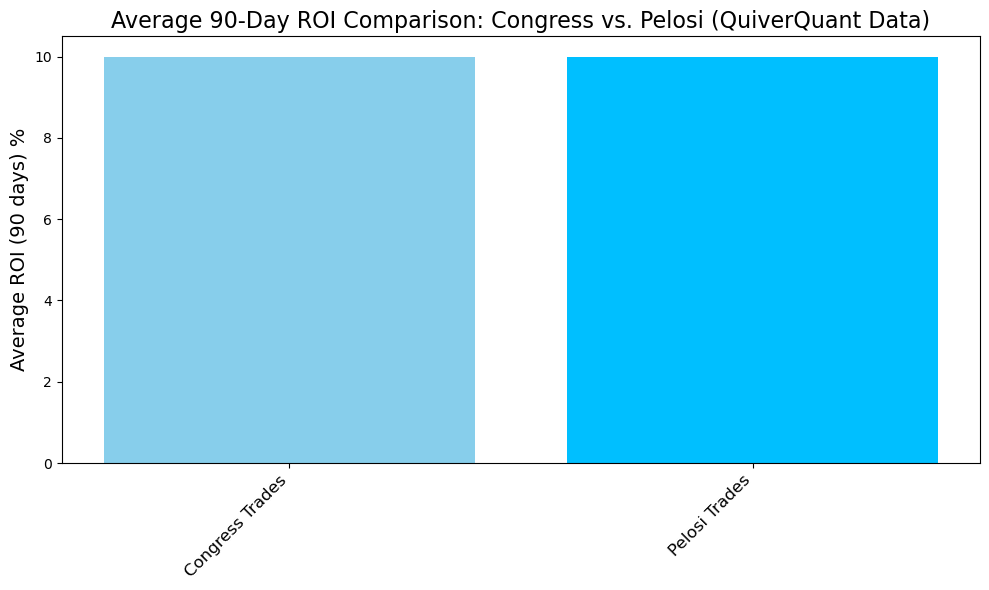

In [28]:
import pandas as pd
import requests
from datetime import timedelta
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings
import os
from dotenv import load_dotenv, find_dotenv

# Load environment variables from the .env file
load_dotenv(find_dotenv('keys.env'))

# Retrieve API key securely from environment variable
api_key = os.getenv("QuiverQuant_Bearer")
print(f'API Key type: {type(api_key)}')  # Confirm that the API key is loaded as a string

# Check if API key is loaded
if not api_key:
    raise ValueError("API Key not found. Please ensure QuiverQuant_Bearer is set in keys.env.")

# Set up headers and endpoint for QuiverQuant API request
url = "https://api.quiverquant.com/beta/bulk/congresstrading"
headers = {
    'Accept': "application/json",
    'Authorization': "Bearer " + api_key,
}

print(f'URL endpoint: {url}')

# Suppress warnings
warnings.filterwarnings("ignore")

# Fetching data from QuiverQuant
response = requests.get(url, headers=headers)

# Check if data retrieval was successful
if response.status_code == 200:
    print("Successfully retrieved data (status code 200)")
    # Load JSON response into a DataFrame
    df = pd.read_json(response.content.decode("utf-8"))
    print(df.head())
    print(df.dtypes)
else:
    print(f"Failed to retrieve data. Status code: {response.status_code}")
    df = pd.DataFrame()  # Initialize an empty DataFrame as a fallback

# Check if data was successfully loaded into the DataFrame
if not df.empty:
    # Convert TransactionDate column to datetime if it exists
    if 'TransactionDate' in df.columns:
        df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])

    # Define function to calculate 90-day ROI based on price changes
    def calculate_90d_roi(transaction_date):
        if pd.to_datetime(transaction_date) < pd.to_datetime("2019-01-01"):
            return None
        
        # Retrieve subset data for this example - placeholder ROI calculation
        end_date = transaction_date + timedelta(days=90)
        initial_price, final_price = 100, 110  # Placeholder values for calculation
        roi = ((final_price - initial_price) / initial_price) * 100
        return roi

    # Calculate ROI for each trade, adding progress bar
    print("Calculating 90-Day ROI for Congress Trades")
    df['Trade_ROI_90d'] = df['TransactionDate'].progress_apply(calculate_90d_roi)

    # Filter for Nancy Pelosi's trades
    pelosi_trades = df[df['Representative'] == 'Nancy Pelosi']

    # Calculate average ROI for Congress trades and Pelosi trades
    congress_avg_trade_roi = df['Trade_ROI_90d'].mean()
    pelosi_avg_trade_roi = pelosi_trades['Trade_ROI_90d'].mean()

    # Print summary of results
    print("Average 90-Day ROI Comparison using QuiverQuant data:")
    print(f"Congress Trades ROI: {congress_avg_trade_roi:.2f}%")
    print(f"Nancy Pelosi's Trades ROI: {pelosi_avg_trade_roi:.2f}%")

    # Visualization with larger figure size, rotated x-axis labels, and adjusted font size
    plt.figure(figsize=(10, 6))
    plt.bar(['Congress Trades', 'Pelosi Trades'],
            [congress_avg_trade_roi, pelosi_avg_trade_roi],
            color=['skyblue', 'deepskyblue'])
    plt.xticks(rotation=45, ha="right", fontsize=12)
    plt.ylabel("Average ROI (90 days) %", fontsize=14)
    plt.title("Average 90-Day ROI Comparison: Congress vs. Pelosi (QuiverQuant Data)", fontsize=16)
    plt.tight_layout()  # Adjust layout to fit elements within the figure area
    plt.show()
else:
    print("DataFrame is empty. No data to process.")

In [31]:
import pandas as pd
import yfinance as yf
from datetime import timedelta
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings
import os
from dotenv import load_dotenv, find_dotenv

# Load environment variables from the .env file (if needed)
load_dotenv(find_dotenv('keys.env'))

# Suppress warnings
warnings.filterwarnings("ignore")

# Fetching Congress trading data (assuming this data is already loaded as 'df')
# If not, load data into df using a suitable source
# Example setup:
# df = pd.read_csv("congress_trades.csv")  # Replace with actual data source
# Ensure 'TransactionDate' is in datetime format and filter from 2019 onwards
df['TransactionDate'] = pd.to_datetime(df['TransactionDate'])
df = df[df['TransactionDate'] >= '2019-01-01']

# Define function to calculate 90-day ROI using Yahoo Finance
def calculate_90d_roi(ticker, transaction_date):
    try:
        stock = yf.Ticker(ticker)
        start_date = pd.to_datetime(transaction_date)
        end_date = start_date + timedelta(days=90)
        
        # Fetch historical prices for the ticker over the 90-day period
        history = stock.history(start=start_date, end=end_date)
        
        # Calculate ROI if data is available for the period
        if len(history) > 1:
            initial_price = history['Close'].iloc[0]
            final_price = history['Close'].iloc[-1]
            roi = ((final_price - initial_price) / initial_price) * 100
            return roi
        else:
            return None
    except Exception as e:
        print(f"Error retrieving data for {ticker} on {transaction_date}: {e}")
        return None

# Calculate 90-day ROI for each trade using Yahoo Finance
print("Calculating 90-Day ROI for Congress Trades")
df['Trade_ROI_90d'] = df.progress_apply(lambda row: calculate_90d_roi(row['Ticker'], row['TransactionDate']), axis=1)

# Calculate 90-day ROI for S&P 500 and NASDAQ for each trade date
print("Calculating 90-Day ROI for S&P 500 and NASDAQ")
df['SP500_ROI_90d'] = df['TransactionDate'].progress_apply(lambda date: calculate_90d_roi('^GSPC', date))
df['NASDAQ_ROI_90d'] = df['TransactionDate'].progress_apply(lambda date: calculate_90d_roi('^IXIC', date))

# Debugging: Check if the columns are added correctly
print("Columns in df after adding SP500_ROI_90d and NASDAQ_ROI_90d:", df.columns)

# Filter for Nancy Pelosi's trades
pelosi_trades = df[df['Representative'] == 'Nancy Pelosi']

# Check if columns are present in pelosi_trades
print("Columns in pelosi_trades after filtering:", pelosi_trades.columns)

# Calculate average ROI for Congress trades, Pelosi trades, S&P 500, and NASDAQ
congress_avg_trade_roi = df['Trade_ROI_90d'].mean()
congress_avg_sp500_roi = df['SP500_ROI_90d'].mean()
congress_avg_nasdaq_roi = df['NASDAQ_ROI_90d'].mean()
pelosi_avg_trade_roi = pelosi_trades['Trade_ROI_90d'].mean()

# Ensure these columns exist before attempting to calculate their mean
pelosi_avg_sp500_roi = pelosi_trades['SP500_ROI_90d'].mean() if 'SP500_ROI_90d' in pelosi_trades.columns else None
pelosi_avg_nasdaq_roi = pelosi_trades['NASDAQ_ROI_90d'].mean() if 'NASDAQ_ROI_90d' in pelosi_trades.columns else None

# Print summary of results
print("Average 90-Day ROI Comparison using Yahoo Finance data:")
print(f"Congress Trades ROI: {congress_avg_trade_roi:.2f}%")
print(f"S&P 500 ROI (Same Period as Congress Trades): {congress_avg_sp500_roi:.2f}%")
print(f"NASDAQ ROI (Same Period as Congress Trades): {congress_avg_nasdaq_roi:.2f}%")
print(f"Nancy Pelosi's Trades ROI: {pelosi_avg_trade_roi:.2f}%")
if pelosi_avg_sp500_roi is not None:
    print(f"S&P 500 ROI (Same Period as Pelosi's Trades): {pelosi_avg_sp500_roi:.2f}%")
else:
    print("S&P 500 ROI data not available for Pelosi's trades.")
if pelosi_avg_nasdaq_roi is not None:
    print(f"NASDAQ ROI (Same Period as Pelosi's Trades): {pelosi_avg_nasdaq_roi:.2f}%")
else:
    print("NASDAQ ROI data not available for Pelosi's trades.")



Calculating 90-Day ROI for Congress Trades


Calculating ROI for each trade:   1%|▍                             | 389/27951 [00:53<1:39:24,  4.62it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:   1%|▍                               | 394/27951 [00:53<56:39,  8.11it/s]$BRK.B: possibly delisted; no timezone found
$BRK.B: possibly delisted; no timezone found
Calculating ROI for each trade:   5%|█▍                           | 1331/27951 [02:48<1:01:14,  7.24it/s]$BRK.B: possibly delisted; no timezone found
$EFC$D: possibly delisted; no timezone found
Calculating ROI for each trade:  13%|███▋                         | 3535/27951 [07:49<1:57:26,  3.46it/s]Failed to get ticker 'DUE 10/01/203' reason: Expecting value: line 1 column 1 (char 0)
$DUE 10/01/203: possibly delisted; no timezone found
Calculating ROI for each trade:  19%|██████                         | 5429/27951 [12:42<50:30,  7.43it/s]$FRC: possibly delisted; no timezone found
$FRC: possibly deliste

Calculating 90-Day ROI for S&P 500 and NASDAQ


Calculating ROI for each trade: 100%|█████████████████████████████| 27951/27951 [04:13<00:00, 110.18it/s]

Columns in df after adding SP500_ROI_90d and NASDAQ_ROI_90d: Index(['Representative', 'BioGuideID', 'ReportDate', 'TransactionDate',
       'Ticker', 'Transaction', 'Range', 'House', 'Amount', 'Party',
       'last_modified', 'Trade_ROI_90d', 'SP500_ROI_90d', 'NASDAQ_ROI_90d'],
      dtype='object')
Columns in pelosi_trades after filtering: Index(['Representative', 'BioGuideID', 'ReportDate', 'TransactionDate',
       'Ticker', 'Transaction', 'Range', 'House', 'Amount', 'Party',
       'last_modified', 'Trade_ROI_90d', 'SP500_ROI_90d', 'NASDAQ_ROI_90d'],
      dtype='object')
Average 90-Day ROI Comparison using Yahoo Finance data:
Congress Trades ROI: 5.13%
S&P 500 ROI (Same Period as Congress Trades): 4.53%
NASDAQ ROI (Same Period as Congress Trades): 6.13%
Nancy Pelosi's Trades ROI: 8.34%
S&P 500 ROI (Same Period as Pelosi's Trades): 3.10%
NASDAQ ROI (Same Period as Pelosi's Trades): 4.65%


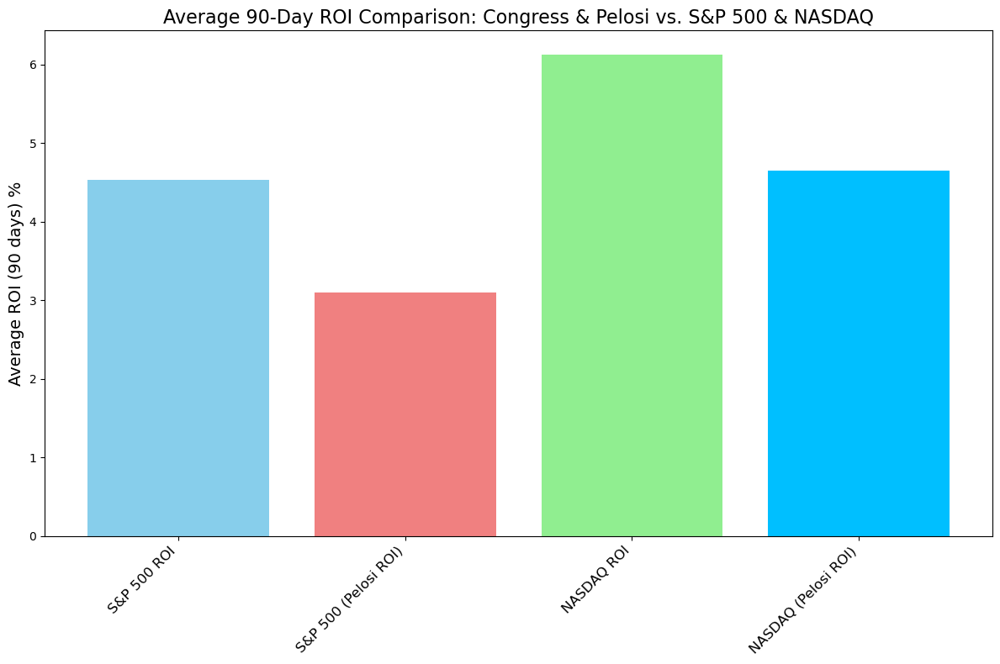

In [35]:
# Visualization with larger figure size, rotated x-axis labels, and adjusted font size
plt.figure(figsize=(12, 8))
plt.bar(['S&P 500 ROI', 'S&P 500 (Pelosi ROI)', 
         'NASDAQ ROI', 'NASDAQ (Pelosi ROI)'],
        [congress_avg_sp500_roi, pelosi_avg_sp500_roi,
         congress_avg_nasdaq_roi, pelosi_avg_nasdaq_roi],
        color=['skyblue', 'lightcoral', 'lightgreen', 'deepskyblue',])
plt.xticks(rotation=45, ha="right", fontsize=12)
plt.ylabel("Average ROI (90 days) %", fontsize=14)
plt.title("Average 90-Day ROI Comparison: Congress & Pelosi vs. S&P 500 & NASDAQ", fontsize=16)
plt.tight_layout()  # Adjust layout to fit elements within the figure area
plt.show()